In [0]:
## Import the necessary library

import pandas as pd
import numpy as np 

import matplotlib as mp
import matplotlib.pyplot as plt
pd.options.mode.chained_assignment = None

import seaborn as sns
sns.set(style="whitegrid")
sns.set(font_scale=2)

In [0]:
# authentification

from google.colab import auth
auth.authenticate_user()
print('Authenticated')

Authenticated


In [0]:
# Link with bigquery platform

from google.cloud import bigquery
client = bigquery.Client('thesisprojects2019')

In [0]:
# linke with drive
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
#import statistic table from bigquery
query = """ SELECT * FROM `thesisprojects2019.audeMS.EDA_spectators` """
data = client.query(query).to_dataframe()

In [0]:
data.head(2)

,venueid,eventid,event,attendance,count_spectators,perc_spectators,count_home,perc_home,count_home_england,perc_home_england,count_home_wales,perc_home_wales,count_home_scotland,perc_home_scotland,count_home_london,perc_home_london,count_home_international,perc_home_international,count_home_undefined,perc_home_undefined,start_region,perc_start,count_start_england,perc_start_england,count_start_wales,perc_start_wales,count_start_scotland,perc_start_scotland,count_start_london,perc_start_london,count_start_international,perc_start_international,count_start_undefined,perc_start_undefined,start_home,perc_start_home,start_not_home,perc_start_not_home,start_home_undefined,perc_start_home_undefined,non_repeat_attendance,perc_non_repeat_attendance,repeat_attendance,perc_repeat_attendance,spect_dist_time_travel_defined,perc_spect_dist_time_travel_defined,spect_dist_time_travel_undefined,perc_spect_dist_time_travel_undefined
0,1,1_2017-11-04,Barbarians New Zealand,63511,1101,1.73,747,67.85,353,32.06,0,0.00,1,0.09,388,35.24,5,0.45,354,32.15,543,49.32,265,24.07,1,0.09,1,0.09,274,24.89,2,0.18,558,50.68,391,35.51,152,13.81,558,50.68,1000,90.83,101,9.17,732,66.49,369,33.51
1,1,1_2017-11-11,England Argentina,81683,1896,2.32,1234,65.08,649,34.23,3,0.16,2,0.11,578,30.49,2,0.11,662,34.92,987,52.06,558,29.43,4,0.21,1,0.05,420,22.15,4,0.21,909,47.94,682,35.97,305,16.09,909,47.94,1654,87.24,242,12.76,1204,63.50,692,36.50


In [0]:
# create space between stadium
data1 = data[data['venueid']==1]
new_data1 = pd.DataFrame([[0] * len(data.columns)], columns=data.columns)
data1 = data1.append(new_data1, ignore_index=True)
data1 = data1.replace({'event':0},{'event':'-'})

data2 = data[data['venueid']==2]
new_data2 = pd.DataFrame([[0] * len(data.columns)], columns=data.columns)
data2 = data2.append(new_data2, ignore_index=True)
data2 = data2.replace({'event':0},{'event':'--'})

data3 = data[data['venueid']==3]
new_data3 = pd.DataFrame([[0] * len(data.columns)], columns=data.columns)
data3 = data3.append(new_data3, ignore_index=True)
data3 = data3.replace({'event':0},{'event':'---'})

data4 = data[data['venueid']==4]

list_df = [data2,data3,data4]
new_data = data1.append(list_df,ignore_index=True )

In [0]:
eventid_list = []
for j in new_data.eventid:
  eventid_list.append(j)

event_list = []
for i in new_data.event:
  event_list.append(i)

In [0]:
new_list = list(zip(event_list,eventid_list))

### GPS Spectators (Percentage, Count) Graph

In [0]:
from matplotlib import pyplot as plt
import numpy as np

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 8) ,dpi=200)

col_pal =  ['tomato','tomato','tomato','tomato','darkorange','darkorange','darkorange','darkorange','darkorange','darkorange','darkorange','darkorange',
           'royalblue','royalblue','royalblue','royalblue','royalblue','royalblue','royalblue','royalblue','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen',
          'seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen']

sns.barplot(x=new_data['event'], y=new_data['perc_spectators'],palette=col_pal)

plt.axhline(new_data.perc_spectators.mean(),ls='--',color='tan')

plt.title('Percentage of GPS Event Spectators', horizontalalignment='center', fontsize='16',fontweight='bold')
plt.xlabel('Event ID',fontsize='16', horizontalalignment='center')
plt.ylabel('Perc. GPS Spectators (% of total ticket sold)',fontsize='16', horizontalalignment='center')
plt.xticks(rotation=35, horizontalalignment='right', fontsize='13')
plt.yticks(horizontalalignment='center', fontsize='13')

ax.tick_params(axis='both', which='major', pad=8)
ax.set_yticks(np.arange(0,5.5,0.5))

plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g1_%_gps_spectators.png')

plt.close('all')

In [0]:
from matplotlib import pyplot as plt
import numpy as np

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 8) ,dpi=200)

col_pal =  ['tomato','tomato','tomato','tomato','darkorange','darkorange','darkorange','darkorange','darkorange','darkorange','darkorange','darkorange',
           'royalblue','royalblue','royalblue','royalblue','royalblue','royalblue','royalblue','royalblue','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen',
          'seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen','seagreen']

sns.barplot(x=new_data['event'], y=new_data['count_spectators'],palette=col_pal)

plt.axhline(new_data.count_spectators.mean(),ls='--',color='tan')

plt.title('Count of GPS Event Spectators', horizontalalignment='center', fontsize='16',fontweight='bold')
plt.xlabel('Event ID',fontsize='16', horizontalalignment='center')
plt.ylabel('Count GPS Spectators',fontsize='16', horizontalalignment='center')
plt.xticks(rotation=30, horizontalalignment='right', fontsize='13')
plt.yticks(horizontalalignment='center', fontsize='13')

ax.tick_params(axis='both', which='major', pad=10)
ax.set_yticks(np.arange(0,2205,200))

plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g1_count_%_gps_spectators.png')

plt.close('all')

### Spectators Origin Home Location Graph


In [0]:
data = new_data
data.head(3)

,venueid,eventid,event,attendance,count_spectators,perc_spectators,count_home,perc_home,count_home_england,perc_home_england,count_home_wales,perc_home_wales,count_home_scotland,perc_home_scotland,count_home_london,perc_home_london,count_home_international,perc_home_international,count_home_undefined,perc_home_undefined,start_region,perc_start,count_start_england,perc_start_england,count_start_wales,perc_start_wales,count_start_scotland,perc_start_scotland,count_start_london,perc_start_london,count_start_international,perc_start_international,count_start_undefined,perc_start_undefined,start_home,perc_start_home,start_not_home,perc_start_not_home,start_home_undefined,perc_start_home_undefined,non_repeat_attendance,perc_non_repeat_attendance,repeat_attendance,perc_repeat_attendance,spect_dist_time_travel_defined,perc_spect_dist_time_travel_defined,spect_dist_time_travel_undefined,perc_spect_dist_time_travel_undefined,test,event_name
0,1,1_2017-11-04,Barbarians New Zealand,63511,1101,1.73,747,67.85,353,32.06,0,0.00,1,0.09,388,35.24,5,0.45,354,32.15,543,49.32,265,24.07,1,0.09,1,0.09,274,24.89,2,0.18,558,50.68,391,35.51,152,13.81,558,50.68,1000,90.83,101,9.17,732,66.49,369,33.51,0 Barbarians New Zealand\n1 ...,"(Barbarians New Zealand, 1_2017-11-04)"
1,1,1_2017-11-11,England Argentina,81683,1896,2.32,1234,65.08,649,34.23,3,0.16,2,0.11,578,30.49,2,0.11,662,34.92,987,52.06,558,29.43,4,0.21,1,0.05,420,22.15,4,0.21,909,47.94,682,35.97,305,16.09,909,47.94,1654,87.24,242,12.76,1204,63.50,692,36.50,0 Barbarians New Zealand\n1 ...,"(England Argentina, 1_2017-11-11)"
2,1,1_2017-11-18,England Australia,81909,1936,2.36,1229,63.48,622,32.13,3,0.15,1,0.05,598,30.89,5,0.26,707,36.52,1007,52.01,558,28.82,2,0.10,0,0.00,442,22.83,5,0.26,929,47.99,678,35.02,329,16.99,929,47.99,1696,87.60,240,12.40,1207,62.35,729,37.65,0 Barbarians New Zealand\n1 ...,"(England Australia, 1_2017-11-18)"


In [0]:
# Draw Plot for GPS Users! With Homelocation
# Select the Variables for plotting
data_graph2_x = data['event']
data_graph2_y1 = data['perc_home']
data_graph2_y2 = data['perc_home_undefined']

# Create the type for each spectators
y_new = np.arange(0,38,1)
home = pd.Series('Home Location Identified', index=y_new)
nohome = pd.Series('Home Location Non-Identified', index=y_new)

# Create the dataframe to use in the graph
# Home
list_home = [data_graph2_x, data_graph2_y1, home]
df_home = pd.DataFrame(list_home) 
# No Home
list_nohome = [data_graph2_x, data_graph2_y2, nohome]
df_nohome = pd.DataFrame(list_nohome) 

# Tranpose the dataframe
df_home_trans = df_home.transpose()
df_home_trans = df_home_trans.rename(columns={'Unnamed 0':'Spectators','perc_home':'perc_spectators'})

df_nohome_trans = df_nohome.transpose()
df_nohome_trans = df_nohome_trans.rename(columns={'Unnamed 0':'Spectators','perc_home_undefined':'perc_spectators'})

# Concat the dataframes
graph2_data = df_nohome_trans.append(df_home_trans)
graph2_data.head(2)

,event,perc_spectators,Spectators
0,Barbarians New Zealand,32.15,Home Location Non-Identified
1,England Argentina,34.92,Home Location Non-Identified


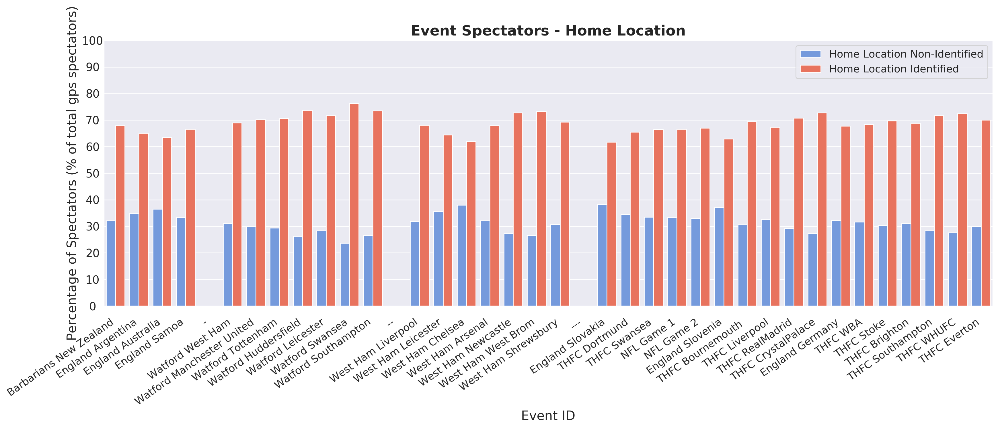

In [0]:
from matplotlib import pyplot as plt
import numpy as np

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 8),dpi=200)

col_pal = ['cornflowerblue','tomato']

sns.barplot(x='event', y='perc_spectators',hue='Spectators', data=graph2_data,palette=col_pal)
#sns.barplot(x=data['event'], y=data['perc_spectators_nohome'],color='cornflowerblue')

plt.title('Event Spectators - Home Location', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Event ID',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of total gps spectators)',fontsize='16', horizontalalignment='center')
plt.xticks(rotation=35, horizontalalignment='right', fontsize='13')
plt.yticks(horizontalalignment='center', fontsize='14')

ax.tick_params(axis='both', which='major', pad=8)
ax.set_yticks(np.arange(0,100.5,10))
#ax.legend(bbox_to_anchor=(1, 0.5))
plt.legend(loc='upper right',fontsize='13')
plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g2_%_spectators_home.png')

In [0]:
data.head(2)

,venueid,eventid,event,attendance,count_spectators,perc_spectators,count_home,perc_home,count_home_england,perc_home_england,count_home_wales,perc_home_wales,count_home_scotland,perc_home_scotland,count_home_london,perc_home_london,count_home_international,perc_home_international,count_home_undefined,perc_home_undefined,start_region,perc_start,count_start_england,perc_start_england,count_start_wales,perc_start_wales,count_start_scotland,perc_start_scotland,count_start_london,perc_start_london,count_start_international,perc_start_international,count_start_undefined,perc_start_undefined,start_home,perc_start_home,start_not_home,perc_start_not_home,start_home_undefined,perc_start_home_undefined,non_repeat_attendance,perc_non_repeat_attendance,repeat_attendance,perc_repeat_attendance
0,1,1_2017-11-04,Barbarians New Zealand,63511,1101,1.73,747,67.85,353,32.06,0,0.00,1,0.09,388,35.24,5,0.45,354,32.15,543,49.32,265,24.07,1,0.09,1,0.09,274,24.89,2,0.18,558,50.68,391,35.51,152,13.81,558,50.68,1000,90.83,101,9.17
1,1,1_2017-11-11,England Argentina,81683,1896,2.32,1234,65.08,649,34.23,3,0.16,2,0.11,578,30.49,2,0.11,662,34.92,987,52.06,558,29.43,4,0.21,1,0.05,420,22.15,4,0.21,909,47.94,682,35.97,305,16.09,909,47.94,1654,87.24,242,12.76


In [0]:
# Draw Plot for GPS Home Users London, Uk, Undefined! 
# Select the Variables for plotting
data_graph4_x = data['event']
data_graph4_y1 = data['perc_home_england']
data_graph4_y2 = data['perc_home_london']
data_graph4_y3 = data['perc_home_wales']
data_graph4_y4 = data['perc_home_scotland']
data_graph4_y5 = data['perc_home_international']
data_graph4_y6 = data['perc_home_undefined']

# Create the type for each spectators
y_new = np.arange(0,38,1)
england = pd.Series('England', index=y_new)
london = pd.Series('London', index=y_new)
wales = pd.Series('Wales', index=y_new)
scotland = pd.Series('Scotland', index=y_new)
international = pd.Series('International', index=y_new)
undef = pd.Series('Unidentified', index=y_new)

# Create the dataframe to use in the graph
# England
list_eng = [data_graph4_x, data_graph4_y1, england]
df_eng = pd.DataFrame(list_eng) 
# London
list_lnd = [data_graph4_x, data_graph4_y2, london]
df_lnd = pd.DataFrame(list_lnd) 
# Wales
list_wales = [data_graph4_x, data_graph4_y3, wales]
df_wales = pd.DataFrame(list_wales) 
# Scotland
list_sct = [data_graph4_x, data_graph4_y4, scotland]
df_sct = pd.DataFrame(list_sct) 
# International
list_international = [data_graph4_x, data_graph4_y5, international]
df_international = pd.DataFrame(list_international) 
# Non Identified
list_undef = [data_graph4_x, data_graph4_y6, undef]
df_undef = pd.DataFrame(list_undef) 


# Tranpose the dataframe
df_eng_trans = df_eng.transpose()
df_eng_trans = df_eng_trans.rename(columns={'Unnamed 0':'Spectators','perc_home_england':'perc_spectators'})

df_lnd_trans = df_lnd.transpose()
df_lnd_trans = df_lnd_trans.rename(columns={'Unnamed 0':'Spectators','perc_home_london':'perc_spectators'})

df_wales_trans = df_wales.transpose()
df_wales_trans = df_wales_trans.rename(columns={'Unnamed 0':'Spectators','perc_home_wales':'perc_spectators'})

df_sct_trans = df_sct.transpose()
df_sct_trans = df_sct_trans.rename(columns={'Unnamed 0':'Spectators','perc_home_scotland':'perc_spectators'})

df_international_trans = df_international.transpose()
df_international_trans = df_international_trans.rename(columns={'Unnamed 0':'Spectators','perc_home_international':'perc_spectators'})

df_undef_trans = df_undef.transpose()
df_undef_trans = df_undef_trans.rename(columns={'Unnamed 0':'Spectators','perc_home_undefined':'perc_spectators'})


# Concat the dataframes
list_df = [df_eng_trans,df_lnd_trans,df_wales_trans,df_sct_trans,df_international_trans]
graph4_data = df_undef_trans.append(list_df)
graph4_data.head(2)

,event,perc_spectators,Spectators
0,Barbarians New Zealand,32.15,Unidentified
1,England Argentina,34.92,Unidentified


In [0]:
graph4_data.Spectators.unique()

array(['Unidentified', 'England', 'London', 'Wales', 'Scotland',
       'International'], dtype=object)

In [0]:
nonuk = graph4_data[(graph4_data['Spectators'] == 'Wales' )| (graph4_data['Spectators'] == 'Scotland') | (graph4_data['Spectators'] == 'International') ]
uk = graph4_data[(graph4_data['Spectators'] == 'London' )| (graph4_data['Spectators'] == 'England') | (graph4_data['Spectators'] == 'Unidentified') ]

#### Graph (England, London, Unidentified)

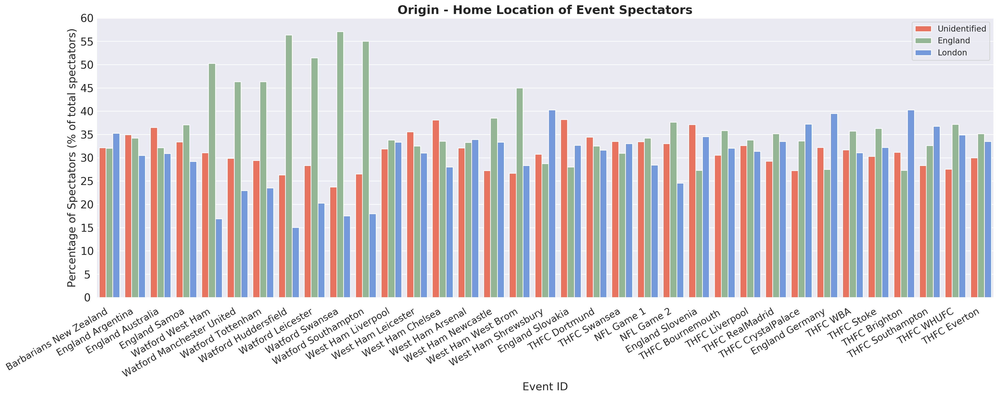

In [0]:
from matplotlib import pyplot as plt
import numpy as np

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(24, 10),dpi=200)

col_pal = ['tomato','darkseagreen','cornflowerblue']

sns.barplot(x='event', y='perc_spectators',hue='Spectators', data=uk,palette=col_pal)

plt.title('Origin - Home Location of Event Spectators', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Event ID',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of total spectators)',fontsize='16', horizontalalignment='center')
plt.xticks(rotation=30, horizontalalignment='right', fontsize='14')
plt.yticks(horizontalalignment='center', fontsize='16')

ax.set_yticks(np.arange(0,60.5,5))
ax.tick_params(axis='both', which='major', pad=8)
plt.legend(loc='upper right',fontsize=12)

plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g4_%_first_spectators_origin.png')

#### Graph (Wales, Scotland, International)

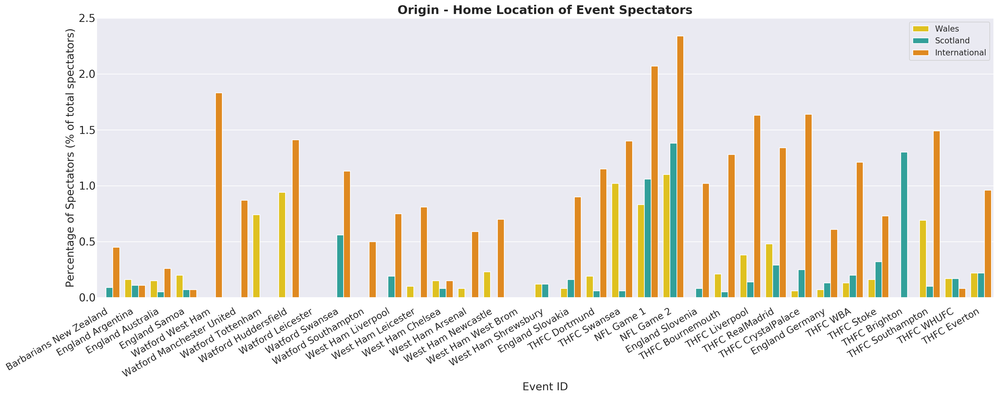

In [0]:
from matplotlib import pyplot as plt
import numpy as np

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(24, 10),dpi=200)

col_pal = ['gold','lightseagreen','darkorange']

sns.barplot(x='event', y='perc_spectators',hue='Spectators', data=nonuk,palette=col_pal)

plt.title('Origin - Home Location of Event Spectators', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Event ID',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of total spectators)',fontsize='16', horizontalalignment='center')
plt.xticks(rotation=30, horizontalalignment='right', fontsize='14')
plt.yticks(horizontalalignment='center', fontsize='16')

ax.set_yticks(np.arange(0,2.6,0.5))
ax.tick_params(axis='both', which='major', pad=8)
plt.legend(loc='upper right',fontsize=12)

plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g4_%_specific_spectators_origin.png')

### Spectators Event Attendance Graph

In [0]:
# Draw Plot for GPS Spectators - Repeat Attendance
# Select the Variables for plotting
data_graph3_x = data['event']
data_graph3_y1 = data['perc_repeat_attendance']
data_graph3_y2 = data['perc_non_repeat_attendance']

# Create the type for each spectators
y_new = np.arange(0,38,1)
repeat = pd.Series('Repeat Attendance', index=y_new)
norepeat = pd.Series('Non-Repeat Attendance', index=y_new)

# Create the dataframe to use in the graph
# Home
list_repeat = [data_graph3_x, data_graph3_y1, repeat]
df_repeat = pd.DataFrame(list_repeat) 
# No Home
list_norepeat = [data_graph3_x, data_graph3_y2, norepeat]
df_norepeat = pd.DataFrame(list_norepeat) 

# Tranpose the dataframe
df_repeat_trans = df_repeat.transpose()
df_repeat_trans = df_repeat_trans.rename(columns={'Unnamed 0':'Spectators','perc_repeat_attendance':'perc_spectators'})

df_norepeat_trans = df_norepeat.transpose()
df_norepeat_trans = df_norepeat_trans.rename(columns={'Unnamed 0':'Spectators','perc_non_repeat_attendance':'perc_spectators'})

# Concat the dataframes
graph3_data = df_repeat_trans.append(df_norepeat_trans)
graph3_data.head(2)

,event,perc_spectators,Spectators
0,Barbarians New Zealand,9.17,Repeat Attendance
1,England Argentina,12.76,Repeat Attendance


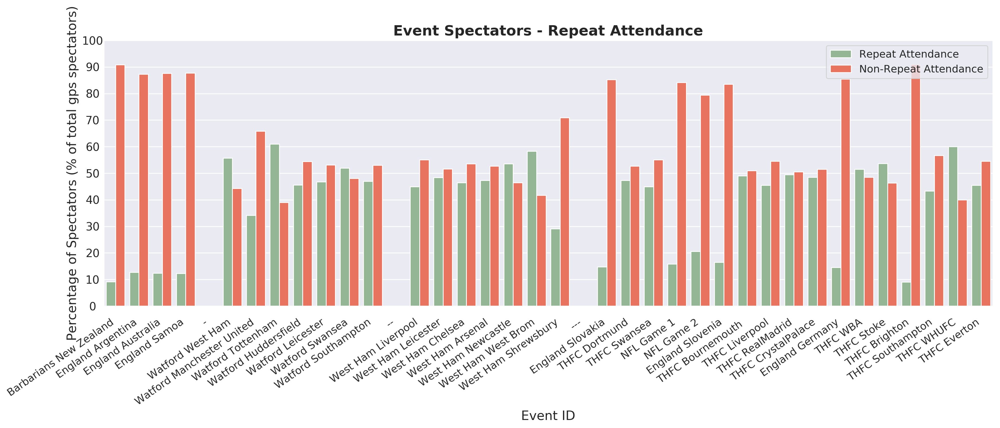

In [0]:
from matplotlib import pyplot as plt
import numpy as np

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 8),dpi=200)

col_pal = ['darkseagreen','tomato']

sns.barplot(x='event', y='perc_spectators',hue='Spectators', data=graph3_data,palette=col_pal)
#sns.barplot(x=data['event'], y=data['perc_spectators_nohome'],color='cornflowerblue')

plt.title('Event Spectators - Repeat Attendance', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Event ID',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of total gps spectators)',fontsize='16', horizontalalignment='center')
plt.xticks(rotation=35, horizontalalignment='right', fontsize='13')
plt.yticks(horizontalalignment='center', fontsize='14')

ax.tick_params(axis='both', which='major', pad=8)
ax.set_yticks(np.arange(0,100.5,10))
#ax.legend(bbox_to_anchor=(1, 0.5))
plt.legend(loc='upper right',fontsize='13')
plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g3_%_spectators_attendance.png')

In [0]:
data.head(2)

,venueid,eventid,event,attendance,count_spectators,perc_spectators,count_home,perc_home,count_home_england,perc_home_england,count_home_wales,perc_home_wales,count_home_scotland,perc_home_scotland,count_home_london,perc_home_london,count_home_international,perc_home_international,count_home_undefined,perc_home_undefined,start_region,perc_start,count_start_england,perc_start_england,count_start_wales,perc_start_wales,count_start_scotland,perc_start_scotland,count_start_london,perc_start_london,count_start_international,perc_start_international,count_start_undefined,perc_start_undefined,start_home,perc_start_home,start_not_home,perc_start_not_home,start_home_undefined,perc_start_home_undefined,non_repeat_attendance,perc_non_repeat_attendance,repeat_attendance,perc_repeat_attendance
0,1,1_2017-11-04,Barbarians New Zealand,63511,1101,1.73,747,67.85,353,32.06,0,0.00,1,0.09,388,35.24,5,0.45,354,32.15,543,49.32,265,24.07,1,0.09,1,0.09,274,24.89,2,0.18,558,50.68,391,35.51,152,13.81,558,50.68,1000,90.83,101,9.17
1,1,1_2017-11-11,England Argentina,81683,1896,2.32,1234,65.08,649,34.23,3,0.16,2,0.11,578,30.49,2,0.11,662,34.92,987,52.06,558,29.43,4,0.21,1,0.05,420,22.15,4,0.21,909,47.94,682,35.97,305,16.09,909,47.94,1654,87.24,242,12.76


### Spectators Home vs. Start Location Graph

In [0]:
# Draw Plot for GPS Spectators - Repeat Attendance
# Select the Variables for plotting
data_graph3_x = data['event']
data_graph3_y1 = data['perc_start_home']
data_graph3_y2 = data['perc_start_not_home']
data_graph3_y3 = data['perc_start_home_undefined']

# Create the type for each spectators
y_new = np.arange(0,38,1)
start_home = pd.Series('Start Location: Home', index=y_new)
start_nothome = pd.Series('Start Location: Not Home', index=y_new)
start_undef = pd.Series('Start Location: Undefined', index=y_new)

# Create the dataframe to use in the graph
# Start Home
list_starthome = [data_graph3_x, data_graph3_y1, start_home]
df_starthome = pd.DataFrame(list_starthome) 
# Start Not Home
list_start_nothome = [data_graph3_x, data_graph3_y2, start_nothome]
df_start_nothome = pd.DataFrame(list_start_nothome) 
# Start Un defined
list_start_undef = [data_graph3_x, data_graph3_y3, start_undef]
df_start_undef = pd.DataFrame(list_start_undef) 

# Tranpose the dataframe
df_starthome_trans = df_starthome.transpose()
df_starthome_trans = df_starthome_trans.rename(columns={'Unnamed 0':'Spectators','perc_start_home':'perc_spectators'})

df_start_nothome_trans = df_start_nothome.transpose()
df_start_nothome_trans = df_start_nothome_trans.rename(columns={'Unnamed 0':'Spectators','perc_start_not_home':'perc_spectators'})

df_start_undef_trans = df_start_undef.transpose()
df_start_undef_trans = df_start_undef_trans.rename(columns={'Unnamed 0':'Spectators','perc_start_home_undefined':'perc_spectators'})

# Concat the dataframes
list_df = [df_start_nothome_trans,df_start_undef_trans]
graph3_data = df_starthome_trans.append(list_df)
graph3_data.head(2)

,event,perc_spectators,Spectators
0,Barbarians New Zealand,35.51,Start Location: Home
1,England Argentina,35.97,Start Location: Home


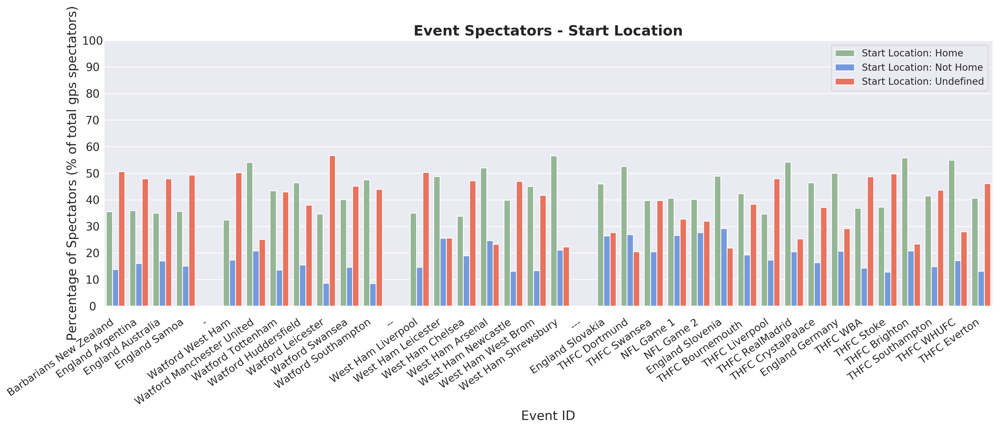

In [0]:
from matplotlib import pyplot as plt
import numpy as np

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 8),dpi=200)

col_pal = ['darkseagreen','cornflowerblue','tomato']

sns.barplot(x='event', y='perc_spectators',hue='Spectators', data=graph3_data,palette=col_pal)
#sns.barplot(x=data['event'], y=data['perc_spectators_nohome'],color='cornflowerblue')

plt.title('Event Spectators - Start Location', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Event ID',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of total gps spectators)',fontsize='16', horizontalalignment='center')
plt.xticks(rotation=35, horizontalalignment='right', fontsize='13')
plt.yticks(horizontalalignment='center', fontsize='14')

ax.tick_params(axis='both', which='major', pad=8)
ax.set_yticks(np.arange(0,100.5,10))
#ax.legend(bbox_to_anchor=(1, 0.5))
plt.legend(loc='upper right',fontsize='12')
plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g5_%_spectators_startlocation.png')

In [0]:
data.head()

,venueid,eventid,event,attendance,count_spectators,perc_spectators,count_home,perc_home,count_home_england,perc_home_england,count_home_wales,perc_home_wales,count_home_scotland,perc_home_scotland,count_home_london,perc_home_london,count_home_international,perc_home_international,count_home_undefined,perc_home_undefined,start_region,perc_start,count_start_england,perc_start_england,count_start_wales,perc_start_wales,count_start_scotland,perc_start_scotland,count_start_london,perc_start_london,count_start_international,perc_start_international,count_start_undefined,perc_start_undefined,start_home,perc_start_home,start_not_home,perc_start_not_home,start_home_undefined,perc_start_home_undefined,non_repeat_attendance,perc_non_repeat_attendance,repeat_attendance,perc_repeat_attendance
0,1,1_2017-11-04,Barbarians New Zealand,63511,1101,1.73,747,67.85,353,32.06,0,0.00,1,0.09,388,35.24,5,0.45,354,32.15,543,49.32,265,24.07,1,0.09,1,0.09,274,24.89,2,0.18,558,50.68,391,35.51,152,13.81,558,50.68,1000,90.83,101,9.17
1,1,1_2017-11-11,England Argentina,81683,1896,2.32,1234,65.08,649,34.23,3,0.16,2,0.11,578,30.49,2,0.11,662,34.92,987,52.06,558,29.43,4,0.21,1,0.05,420,22.15,4,0.21,909,47.94,682,35.97,305,16.09,909,47.94,1654,87.24,242,12.76
2,1,1_2017-11-18,England Australia,81909,1936,2.36,1229,63.48,622,32.13,3,0.15,1,0.05,598,30.89,5,0.26,707,36.52,1007,52.01,558,28.82,2,0.10,0,0.00,442,22.83,5,0.26,929,47.99,678,35.02,329,16.99,929,47.99,1696,87.60,240,12.40
3,1,1_2017-11-25,England Samoa,81911,1533,1.87,1021,66.60,568,37.05,3,0.20,1,0.07,448,29.22,1,0.07,512,33.40,777,50.68,432,28.18,3,0.20,0,0.00,340,22.18,2,0.13,756,49.32,546,35.62,231,15.07,756,49.32,1344,87.67,189,12.33
4,0,0,-,0,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00,0,0.00


### Spectators Start Location Graph
(England, London, Wales, Scotland, Oversea, Unidentified)

In [0]:
# Draw Plot for GPS Home Users London, Uk, Undefined! 
# Select the Variables for plotting
data_graph4_x = data['event']
data_graph4_y1 = data['perc_start_england']
data_graph4_y2 = data['perc_start_london']
data_graph4_y3 = data['perc_start_wales']
data_graph4_y4 = data['perc_start_scotland']
data_graph4_y5 = data['perc_start_international']
data_graph4_y6 = data['perc_start_undefined']

# Create the type for each spectators
y_new = np.arange(0,38,1)
england = pd.Series('England', index=y_new)
london = pd.Series('London', index=y_new)
wales = pd.Series('Wales', index=y_new)
scotland = pd.Series('Scotland', index=y_new)
international = pd.Series('International', index=y_new)
undef = pd.Series('Unidentified', index=y_new)

# Create the dataframe to use in the graph
# England
list_eng = [data_graph4_x, data_graph4_y1, england]
df_eng = pd.DataFrame(list_eng) 
# London
list_lnd = [data_graph4_x, data_graph4_y2, london]
df_lnd = pd.DataFrame(list_lnd) 
# Wales
list_wales = [data_graph4_x, data_graph4_y3, wales]
df_wales = pd.DataFrame(list_wales) 
# Scotland
list_sct = [data_graph4_x, data_graph4_y4, scotland]
df_sct = pd.DataFrame(list_sct) 
# International
list_international = [data_graph4_x, data_graph4_y5, international]
df_international = pd.DataFrame(list_international) 
# Non Identified
list_undef = [data_graph4_x, data_graph4_y6, undef]
df_undef = pd.DataFrame(list_undef) 


# Tranpose the dataframe
df_eng_trans = df_eng.transpose()
df_eng_trans = df_eng_trans.rename(columns={'Unnamed 0':'Spectators','perc_start_england':'perc_spectators'})

df_lnd_trans = df_lnd.transpose()
df_lnd_trans = df_lnd_trans.rename(columns={'Unnamed 0':'Spectators','perc_start_london':'perc_spectators'})

df_wales_trans = df_wales.transpose()
df_wales_trans = df_wales_trans.rename(columns={'Unnamed 0':'Spectators','perc_start_wales':'perc_spectators'})

df_sct_trans = df_sct.transpose()
df_sct_trans = df_sct_trans.rename(columns={'Unnamed 0':'Spectators','perc_start_scotland':'perc_spectators'})

df_international_trans = df_international.transpose()
df_international_trans = df_international_trans.rename(columns={'Unnamed 0':'Spectators','perc_start_international':'perc_spectators'})

df_undef_trans = df_undef.transpose()
df_undef_trans = df_undef_trans.rename(columns={'Unnamed 0':'Spectators','perc_start_undefined':'perc_spectators'})


# Concat the dataframes
list_df = [df_eng_trans,df_lnd_trans,df_wales_trans,df_sct_trans,df_international_trans]
graph4_data = df_undef_trans.append(list_df)
graph4_data.head(2)

,event,perc_spectators,Spectators
0,Barbarians New Zealand,50.68,Unidentified
1,England Argentina,47.94,Unidentified


In [0]:
nonuk = graph4_data[(graph4_data['Spectators'] == 'Wales' )| (graph4_data['Spectators'] == 'Scotland') | (graph4_data['Spectators'] == 'International') ]
uk = graph4_data[(graph4_data['Spectators'] == 'London' )| (graph4_data['Spectators'] == 'England') | (graph4_data['Spectators'] == 'Unidentified') ]

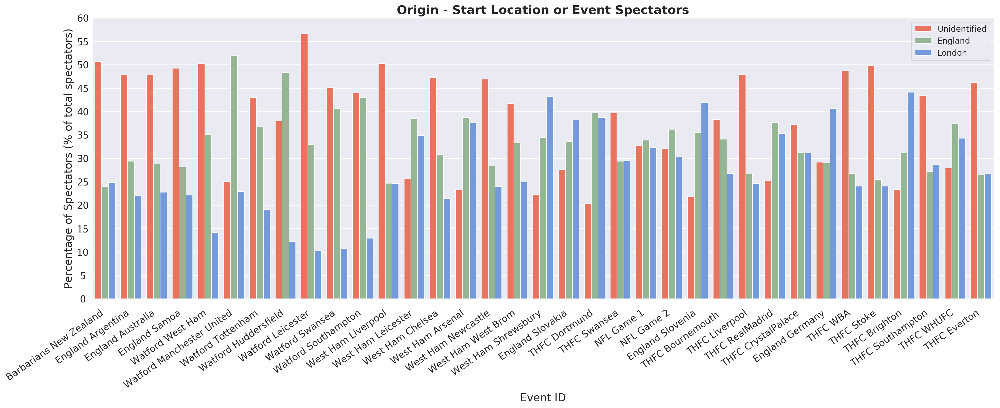

In [0]:
from matplotlib import pyplot as plt
import numpy as np

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(24, 10),dpi=200)

col_pal = ['tomato','darkseagreen','cornflowerblue']

sns.barplot(x='event', y='perc_spectators',hue='Spectators', data=uk,palette=col_pal)

plt.title('Origin - Start Location or Event Spectators', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Event ID',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of total spectators)',fontsize='16', horizontalalignment='center')
plt.xticks(rotation=35, horizontalalignment='right', fontsize='14')
plt.yticks(horizontalalignment='center', fontsize='14')

ax.set_yticks(np.arange(0,60.5,5))
ax.tick_params(axis='both', which='major', pad=8)
plt.legend(loc='upper right',fontsize=12)

plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g6_%_spectators_uk_startlocation.png')

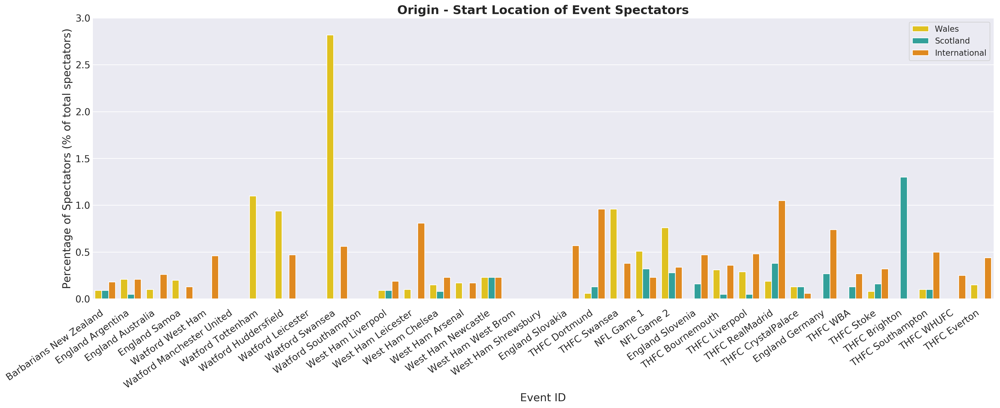

In [0]:
from matplotlib import pyplot as plt
import numpy as np

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(24, 10),dpi=200)

col_pal =['gold','lightseagreen','darkorange']

sns.barplot(x='event', y='perc_spectators',hue='Spectators', data=nonuk,palette=col_pal)

plt.title('Origin - Start Location of Event Spectators', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Event ID',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of total spectators)',fontsize='16', horizontalalignment='center')
plt.xticks(rotation=35, horizontalalignment='right', fontsize='14')
plt.yticks(horizontalalignment='center', fontsize='14')

ax.set_yticks(np.arange(0,3.1,0.5))
ax.tick_params(axis='both', which='major', pad=8)
plt.legend(loc='upper right',fontsize=12)

plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g6_%_nonuk_spectators_startlocation.png')

### ACORN CLASSIFICATION - SINGLE EVENT
ACORN group graphs

In [0]:
#import statistic table from bigquery
query = """ SELECT  b.event_type, b.acorn_group, COUNT(user_id) as count_spect,
                              ROUND((COUNT(user_id)/a.count_tot_spect)*100,2) as perc_spect
                 FROM (              
                          SELECT event_type, COUNT(user_id) as count_tot_spect
                          FROM `thesisprojects2019.audeMS.prediction_spectators_final` 
                         WHERE acorn_group != 'undefined'
                         GROUP BY event_type ) as a, 
                          `thesisprojects2019.audeMS.prediction_spectators_final` as b
                 WHERE b.acorn_group != 'undefined' AND a.event_type = b.event_type
                 GROUP BY acorn_group, event_type, count_tot_spect ORDER BY acorn_group """
data = client.query(query).to_dataframe()

In [0]:
data.head()

,event_type,acorn_group,count_spect,perc_spect
0,Premier League,A,492,2.36
1,Champions League,A,88,2.41
2,Rugby International,A,260,4.02
3,International Football,A,69,1.73
4,NFL,A,31,0.85


In [0]:
data_rename = data.replace({'A':'A - Lavish Lifestyles','B':'B - Executive Wealth','C':'C - Mature Money','D':'D - City Sophisticates',
                           'E':'E - Career Climbers','F':'F - Countryside Communities','G':'G - Successful Suburbs','H':'H - Steady Neighbourhoods',
                           'I':'I - Comfortable Seniors','J':'J - Starting Out','K':'K - Student Life','L':'L - Modest Means',
                           'M':'M - Striving Families','N':'N - Poorer Pensioners','O':'O - Young Hardship','P':'P - Struggling Estates',
                           'Q':'Q - Difficult Circumstances', 'R':'Not Private Households'})

In [0]:
data_rename.head()

,event_type,acorn_group,count_spect,perc_spect
0,Premier League,A - Lavish Lifestyles,492,2.36
1,Champions League,A - Lavish Lifestyles,88,2.41
2,Rugby International,A - Lavish Lifestyles,260,4.02
3,International Football,A - Lavish Lifestyles,69,1.73
4,NFL,A - Lavish Lifestyles,31,0.85


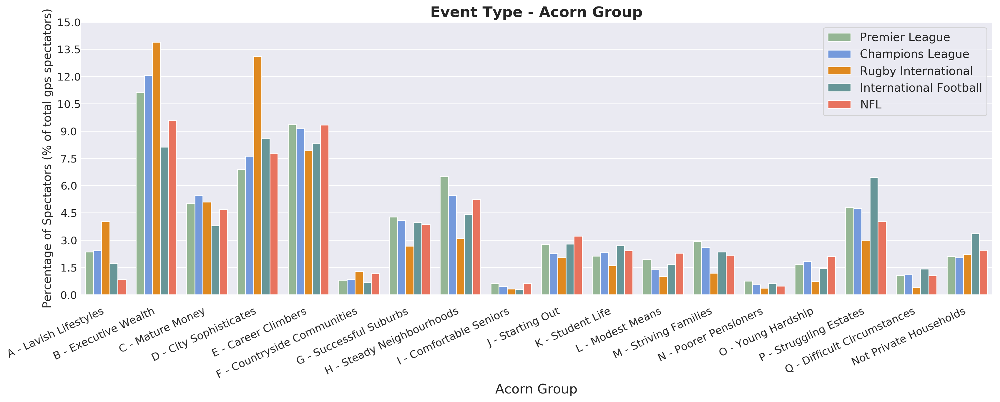

In [0]:
from matplotlib import pyplot as plt
import numpy as np
import seaborn as sns 

sns.set(style="whitegrid")
sns.set(font_scale=2)

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 8),dpi=200)

col_pal = ['darkseagreen','cornflowerblue','darkorange','cadetblue','tomato']

sns.barplot(x='acorn_group', y='perc_spect',hue='event_type', data=data_rename, palette=col_pal)
#sns.barplot(x=data['event'], y=data['perc_spectators_nohome'],color='cornflowerblue')

plt.title('Event Type - Acorn Group', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Acorn Group',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of total gps spectators)',fontsize='14', horizontalalignment='center')
plt.xticks(rotation=25, horizontalalignment='right', fontsize='13')
plt.yticks(horizontalalignment='center', fontsize='13')

ax.tick_params(axis='both', which='major', pad=8)
ax.set_yticks(np.arange(0,15.5,1.5))
#ax.legend(bbox_to_anchor=(1, 0.5))
plt.legend(loc='upper right',fontsize='14')
#ax.set_yticks(np.arange(0,23,2))
plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g7_acorn_group.png')

### ACORN CLASSIFICATION - SINGLE EVENT
ACORN category graphs

In [0]:
#import statistic table from bigquery
query = """ SELECT  b.event_type, b.acorn_group, COUNT(user_id) as count_spect,
                              ROUND((COUNT(user_id)/a.count_tot_spect)*100,2) as perc_spect
                 FROM (              
                          SELECT event_type, COUNT(user_id) as count_tot_spect
                          FROM `thesisprojects2019.audeMS.prediction_spectators_final` 
                         WHERE acorn_group != 'undefined'
                         GROUP BY event_type ) as a, 
                          `thesisprojects2019.audeMS.prediction_spectators_final` as b
                 WHERE b.acorn_group != 'undefined' AND a.event_type = b.event_type
                 GROUP BY acorn_group, event_type, count_tot_spect ORDER BY acorn_group """
dataacorn = client.query(query).to_dataframe()

In [0]:
dataacorn = dataacorn.replace({'A':'A - Lavish Lifestyles','B':'B - Executive Wealth','C':'C - Mature Money','D':'D - City Sophisticates',
                           'E':'E - Career Climbers','F':'F - Countryside Communities','G':'G - Successful Suburbs','H':'H - Steady Neighbourhoods',
                           'I':'I - Comfortable Seniors','J':'J - Starting Out','K':'K - Student Life','L':'L - Modest Means',
                           'M':'M - Striving Families','N':'N - Poorer Pensioners','O':'O - Young Hardship','P':'P - Struggling Estates',
                           'Q':'Q - Difficult Circumstances', 'R':'Not Private Households'})

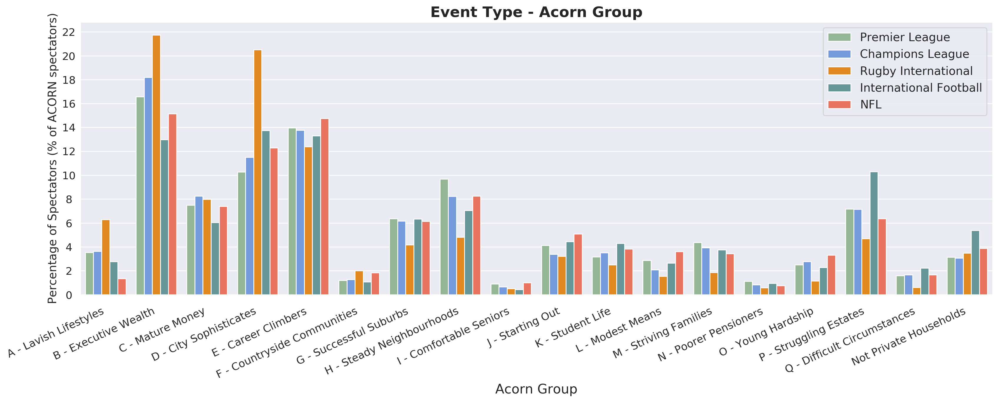

In [0]:
from matplotlib import pyplot as plt
import numpy as np
import seaborn as sns 

sns.set(style="whitegrid")
sns.set(font_scale=2)

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 8),dpi=200)

col_pal = ['darkseagreen','cornflowerblue','darkorange','cadetblue','tomato']

sns.barplot(x='acorn_group', y='perc_spect',hue='event_type', data=dataacorn, palette=col_pal)
#sns.barplot(x=data['event'], y=data['perc_spectators_nohome'],color='cornflowerblue')

plt.title('Event Type - Acorn Group', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Acorn Group',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of ACORN spectators)',fontsize='14', horizontalalignment='center')
plt.xticks(rotation=25, horizontalalignment='right', fontsize='13')
plt.yticks(horizontalalignment='center', fontsize='13')

ax.tick_params(axis='both', which='major', pad=8)
ax.set_yticks(np.arange(0,22.5,2.0))
#ax.legend(bbox_to_anchor=(1, 0.5))
plt.legend(loc='upper right',fontsize='14')
#ax.set_yticks(np.arange(0,23,2))
plt.subplots_adjust(bottom=0.30)

#plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g7_acorn_group_new.png')

In [0]:
#import statistic table from bigquery
query = """ SELECT  b.event_type, b.acorn_category, COUNT(user_id) as count_spect,
                              ROUND((COUNT(user_id)/a.count_tot_spect)*100,2) as perc_spect
                 FROM (              
                          SELECT event_type, COUNT(user_id) as count_tot_spect
                          FROM `thesisprojects2019.audeMS.prediction_spectators_final` 
                         GROUP BY event_type ) as a, 
                          `thesisprojects2019.audeMS.prediction_spectators_final` as b
                 WHERE b.acorn_category != -1 AND a.event_type = b.event_type
                 GROUP BY acorn_category, event_type, count_tot_spect ORDER BY acorn_category """
data_acorn_cat = client.query(query).to_dataframe()

In [0]:
data_acorn_cat.head(2)

,event_type,acorn_category,count_spect,perc_spect
0,Premier League,1.0,3860,18.48
1,Champions League,1.0,728,19.95


In [0]:
data_acorn_cat = data_acorn_cat.replace({1.0:'1 - Affluent Achievers',2.0:'2 - Rising Prosperity',3.0:'3 - Comfortable Communities',
                               4.0:'4 - Financially Stretched', 5.0:'5 - Urban Adversity',6.0:'6 - Not Private Households'})

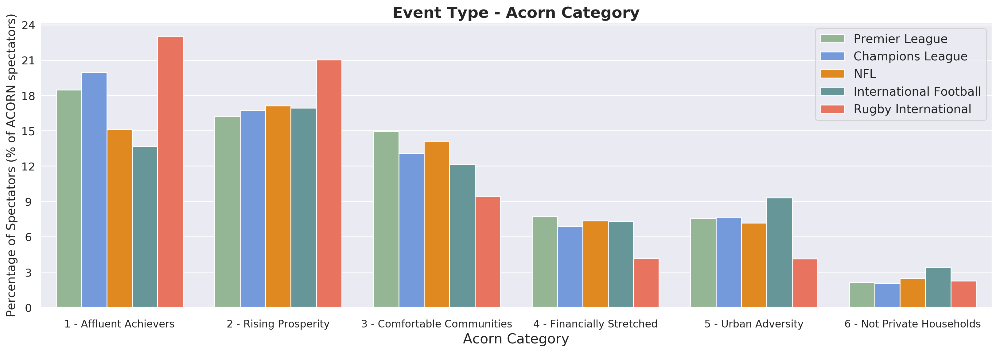

In [0]:
from matplotlib import pyplot as plt
import numpy as np
import seaborn as sns 

sns.set(style="whitegrid")
sns.set(font_scale=2)

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 8),dpi=200)

col_pal = ['darkseagreen','cornflowerblue','darkorange','cadetblue','tomato']

sns.barplot(x='acorn_category', y='perc_spect',hue='event_type', data=data_acorn_cat, palette=col_pal)
#sns.barplot(x=data['event'], y=data['perc_spectators_nohome'],color='cornflowerblue')

plt.title('Event Type - Acorn Category', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Acorn Category',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of ACORN spectators)',fontsize='14', horizontalalignment='center')
plt.xticks(horizontalalignment='center', fontsize='12')
plt.yticks(horizontalalignment='center', fontsize='13')

ax.tick_params(axis='both', which='major', pad=8)
ax.set_yticks(np.arange(0,24.5,3.0))
#ax.legend(bbox_to_anchor=(1, 0.5))
plt.legend(loc='upper right',fontsize='14')
#ax.set_yticks(np.arange(0,23,2))
plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/g8_acorn_categories.png')

In [0]:
query = """SELECT b.event, b.acorn_group, IF(a.count_spect IS NULL, 0, a.count_spect) as count_spect, 
                             IF(a.perc_spect IS NULL, 0, a.perc_spect) as perc_spect
              FROM `thesisprojects2019.audeMS.acorn_group_event`as a
              RIGHT JOIN (SELECT DISTINCT a.acorn_group, b.event
                                  FROM `thesisprojects2019.audeMS.acorn_group_event` as a, 
                                            `thesisprojects2019.audeMS.prediction_spectators_final` as b) as b
              ON a.event = b.event AND a.acorn_group = b.acorn_group
              ORDER BY event, acorn_group"""
dataevent =  client.query(query).to_dataframe()

In [0]:
dataevent = dataevent.replace({'A':'A - Lavish Lifestyles','B':'B - Executive Wealth','C':'C - Mature Money','D':'D - City Sophisticates',
                           'E':'E - Career Climbers','F':'F - Countryside Communities','G':'G - Successful Suburbs','H':'H - Steady Neighbourhoods',
                           'I':'I - Comfortable Seniors','J':'J - Starting Out','K':'K - Student Life','L':'L - Modest Means',
                           'M':'M - Striving Families','N':'N - Poorer Pensioners','O':'O - Young Hardship','P':'P - Struggling Estates',
                           'Q':'Q - Difficult Circumstances', 'R':'R - Not Private Households'})
dataevent.head(2)

,event,acorn_group,count_spect,perc_spect
0,Barbarians New Zealand,A - Lavish Lifestyles,32,4.37
1,Barbarians New Zealand,B - Executive Wealth,149,20.36


In [0]:
# Get the list of all the event
event_list = []
for i in dataevent.event.unique():
  if i not in event_list:
    event_list.append(i)

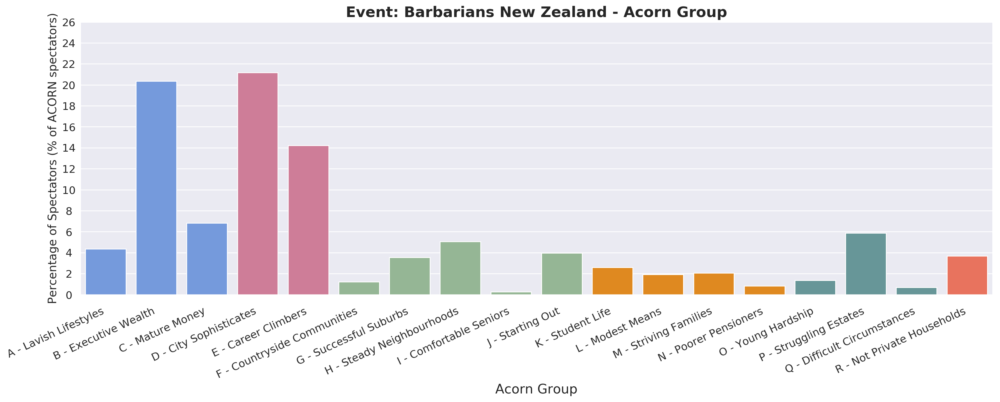

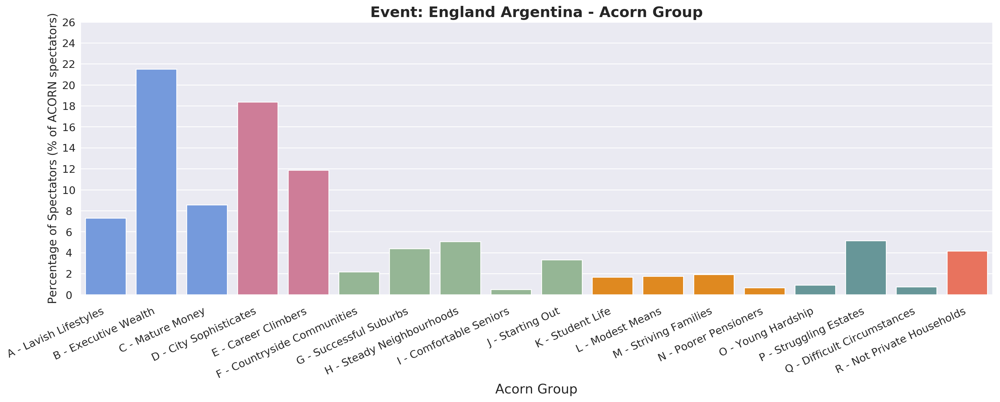

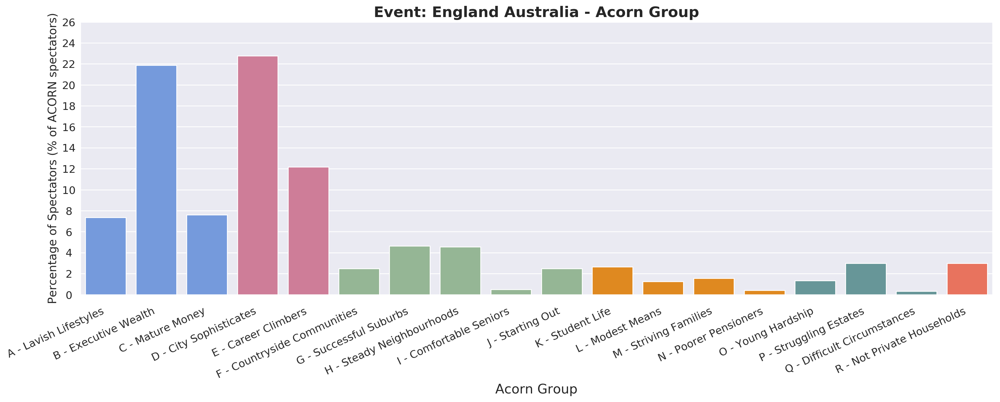

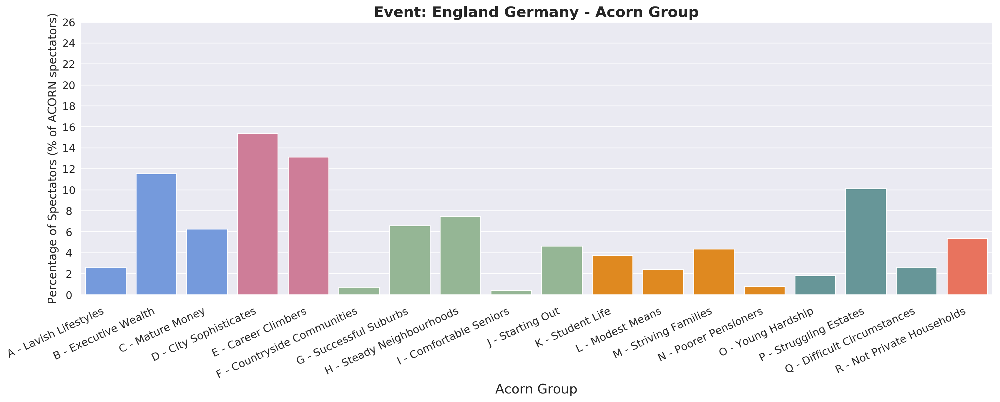

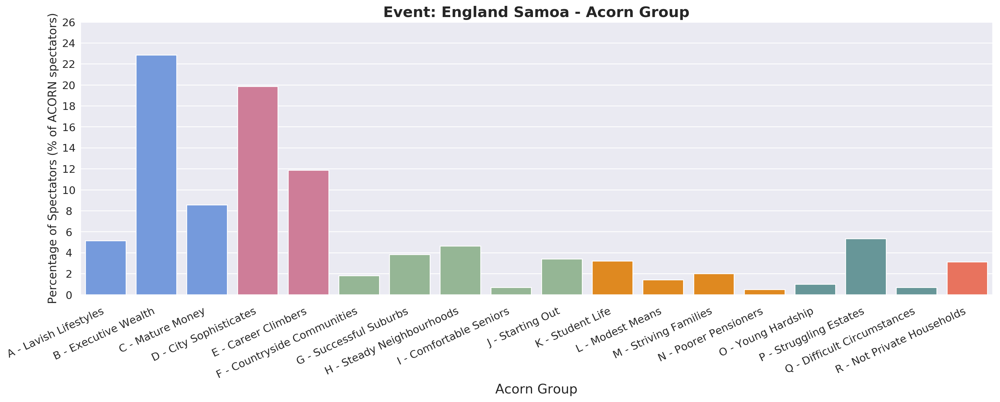

...

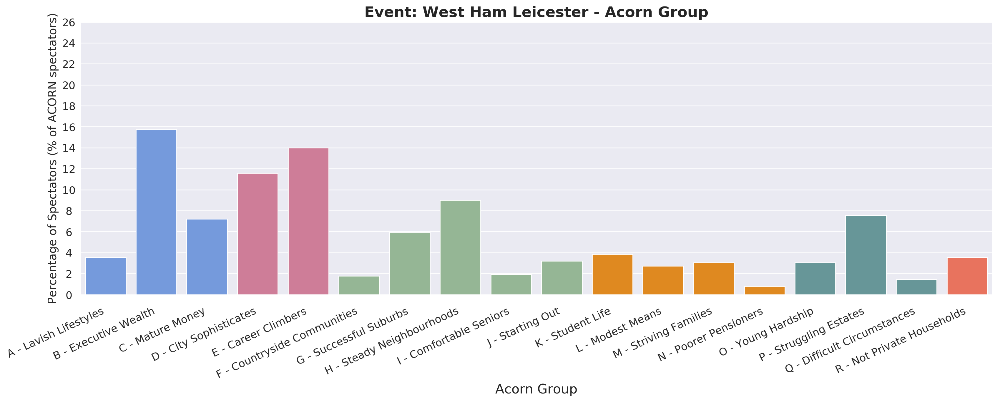

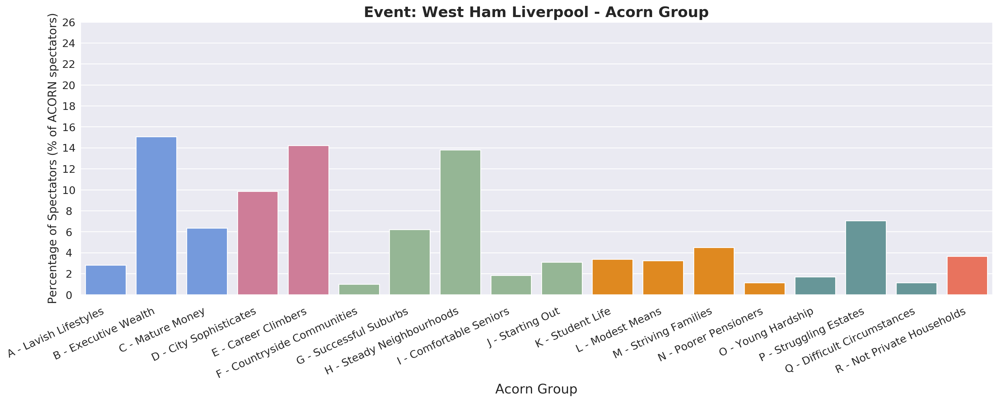

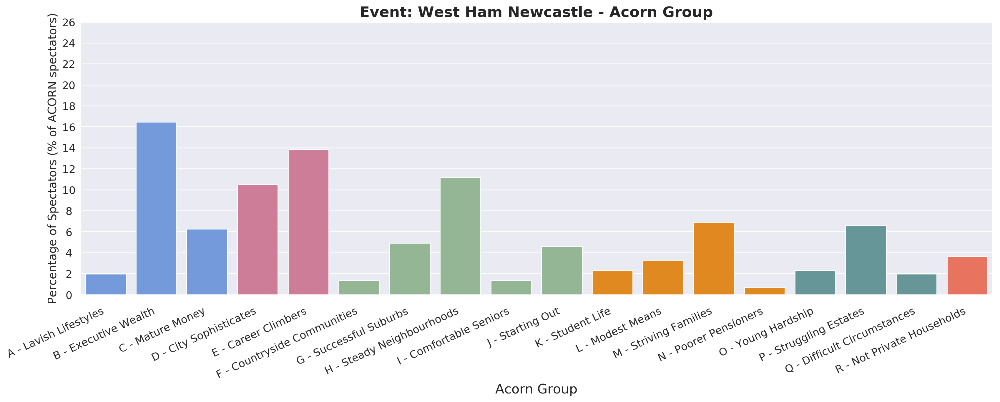

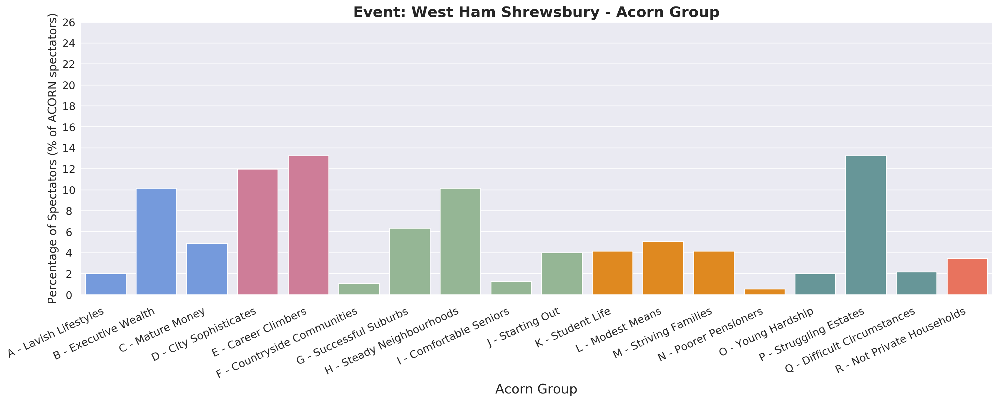

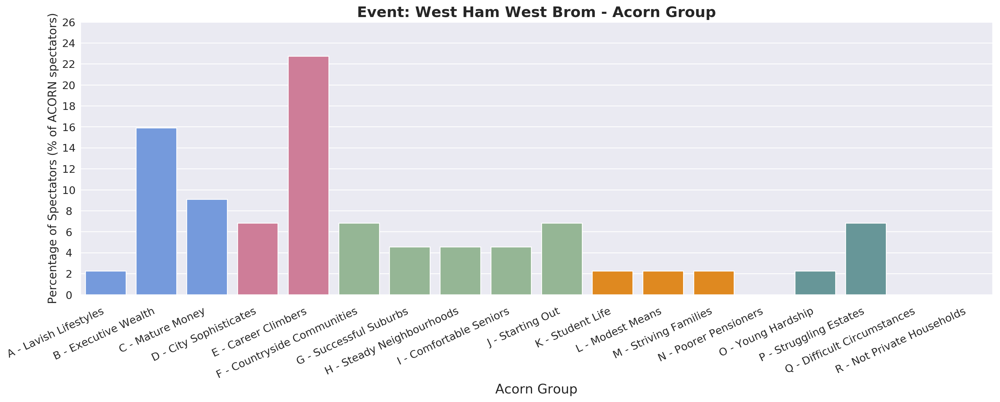

In [0]:
for i in event_list:
  
  # selection only the specific event from the data
  data_acorn_sel = dataevent[dataevent['event']==i]

  # Set up the matplotlib figure
  f, ax = plt.subplots(figsize=(20, 8),dpi=200)
  
  col_pal = ['cornflowerblue','cornflowerblue','cornflowerblue','palevioletred','palevioletred','darkseagreen','darkseagreen','darkseagreen',
            'darkseagreen','darkseagreen','darkorange','darkorange','darkorange','darkorange','cadetblue','cadetblue','cadetblue','tomato']
  
  #sns.barplot(x='acorn_group', y='perc_spect',hue='event', data=data_acorn_sel, palette=col_pal)
  sns.barplot(x='acorn_group', y='perc_spect', data=data_acorn_sel, palette=col_pal)
  
  plt.title('Event: ' + str(i) + ' - Acorn Group', horizontalalignment='center', fontsize='18',fontweight='bold')
  plt.xlabel('Acorn Group',fontsize='16', horizontalalignment='center')
  plt.ylabel('Percentage of Spectators (% of ACORN spectators)',fontsize='14', horizontalalignment='center')
  plt.xticks(rotation=25, horizontalalignment='right', fontsize='13')
  plt.yticks(horizontalalignment='center', fontsize='13')
  
  ax.tick_params(axis='both', which='major', pad=8)
  ax.set_yticks(np.arange(0,26.5,2.0))
  #ax.legend(bbox_to_anchor=(1, 0.5))
  #ax.set_yticks(np.arange(0,23,2))
  plt.subplots_adjust(bottom=0.30)
  
 # plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/ACORN groups/acorn_group_'+str(i)+'.png')
  #plt.close('all')
  plt.show()

In [0]:
from google.colab import files
import os

folderpath = 'drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/Graphs/ACORN groups/'

for filename in os.listdir(folderpath):
  files.download(folderpath+'/'+str(filename))

### ACORN CLASSIFICATION 
### Event and Venue Category

ACORN groups graphs

In [0]:
#import statistic table from bigquery
query = """ SELECT  b.venue, b.event_type, b.acorn_group, COUNT(user_id) as count_spect,
                               ROUND((COUNT(user_id)/a.count_spect)*100,2) as perc_spect
                 FROM (              
                             SELECT event_type, venue, COUNT(user_id) as count_spect
                             FROM `thesisprojects2019.audeMS.prediction_spectators_final` 
                             WHERE acorn_group != 'undefined'
                             GROUP BY event_type, venue ) as a, 
                             `thesisprojects2019.audeMS.prediction_spectators_final` as b
                 WHERE b.acorn_group != 'undefined' AND a.event_type = b.event_type AND a.venue = b.venue
                 GROUP BY acorn_group, venue, event_type, a.count_spect ORDER BY acorn_group """
data = client.query(query).to_dataframe()

In [0]:
data['venue_eventtype'] = data[['event_type', 'venue']].apply(lambda x: ' - '.join(x), axis=1)
data.head(2)

,venue,event_type,acorn_group,count_spect,perc_spect,venue_eventtype
0,wembley stadium,Premier League,A,325,3.56,Premier League - wembley stadium
1,wembley stadium,Champions League,A,88,3.64,Champions League - wembley stadium


In [0]:
venue_eventtype_list = []
for i in data.venue_eventtype:
    if i not in venue_eventtype_list:
        venue_eventtype_list.append(i)

In [0]:
dataacorn = data.replace({'A':'A - Lavish Lifestyles','B':'B - Executive Wealth','C':'C - Mature Money','D':'D - City Sophisticates',
                           'E':'E - Career Climbers','F':'F - Countryside Communities','G':'G - Successful Suburbs','H':'H - Steady Neighbourhoods',
                           'I':'I - Comfortable Seniors','J':'J - Starting Out','K':'K - Student Life','L':'L - Modest Means',
                           'M':'M - Striving Families','N':'N - Poorer Pensioners','O':'O - Young Hardship','P':'P - Struggling Estates',
                           'Q':'Q - Difficult Circumstances', 'R':'Not Private Households'})

In [0]:
dataacorn.head()

,venue,event_type,acorn_group,count_spect,perc_spect,venue_eventtype
0,wembley stadium,Premier League,A - Lavish Lifestyles,325,3.56,Premier League - wembley stadium
1,wembley stadium,Champions League,A - Lavish Lifestyles,88,3.64,Champions League - wembley stadium
2,twickenham,Rugby International,A - Lavish Lifestyles,260,6.29,Rugby International - twickenham
3,wembley stadium,International Football,A - Lavish Lifestyles,69,2.76,International Football - wembley stadium
4,london stadium,Premier League,A - Lavish Lifestyles,117,3.05,Premier League - london stadium


In [0]:
dataacorn= dataacorn.sort_values(['acorn_group','event_type','venue'])

In [0]:
from matplotlib import pyplot as plt
import numpy as np
import seaborn as sns 

sns.set(style="whitegrid")
sns.set(font_scale=2)

for e in venue_eventtype_list:
  
  datatoplot = dataacorn[dataacorn['venue_eventtype']==e]
  
  # Set up the matplotlib figure
  f, ax = plt.subplots(figsize=(16, 8),dpi=200)
 # f, ax = plt.subplots(figsize=(16, 8))
  
 # col_pal = ['darkseagreen','cornflowerblue','darkorange','cadetblue','tomato']
  col_pal = ['cornflowerblue','cornflowerblue','cornflowerblue','palevioletred','palevioletred','darkseagreen','darkseagreen','darkseagreen',
            'darkseagreen','darkseagreen','darkorange','darkorange','darkorange','darkorange','cadetblue','cadetblue','cadetblue','tomato']
 
 # sns.barplot(x='acorn_group', y='perc_spect',hue='event_type', data=datatoplot, palette=col_pal)
  sns.barplot(x=datatoplot['acorn_group'], y=datatoplot['perc_spect'],palette=col_pal)
  
  plt.title(str(e) + ' - Acorn Group', horizontalalignment='center', fontsize='18',fontweight='bold')
  plt.xlabel('Acorn Group',fontsize='16', horizontalalignment='center')
  plt.ylabel('Percentage of Spectators (% of ACORN spectators)',fontsize='14', horizontalalignment='center')
  plt.xticks(rotation=25, horizontalalignment='right', fontsize='13')
  plt.yticks(horizontalalignment='center', fontsize='13')
  
  ax.tick_params(axis='both', which='major', pad=8)
  ax.set_yticks(np.arange(0,22.5,2.0))
  #ax.legend(bbox_to_anchor=(1, 0.5))
 # plt.legend(loc='upper right',fontsize='14')
  #ax.set_yticks(np.arange(0,23,2))
  plt.subplots_adjust(bottom=0.30)
  
  plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/EventType_Maps_Graphs/Graphs_Acorn/'+str(e)+'acorn_group.png')
  plt.show()
  

In [0]:
from matplotlib import pyplot as plt
import numpy as np
import seaborn as sns 

sns.set(style="whitegrid")
sns.set(font_scale=2)


  
# Set up the matplotlib figure
# f, ax = plt.subplots(figsize=(20, 8),dpi=200)
f, ax = plt.subplots(figsize=(19, 8),dpi=160)

col_pal = ['gold','cornflowerblue','darkorange','cadetblue','tomato','darkseagreen','palevioletred']
# col_pal = ['cornflowerblue','cornflowerblue','cornflowerblue','palevioletred','palevioletred','darkseagreen','darkseagreen','darkseagreen',
#                'darkseagreen','darkseagreen','darkorange','darkorange','darkorange','darkorange','cadetblue','cadetblue','cadetblue','tomato']
sns.barplot(x='acorn_group', y='perc_spect',hue='venue_eventtype', data=dataacorn, palette=col_pal)
# sns.barplot(x=datatoplot['acorn_group'], y=datatoplot['perc_spect'],palette=col_pal)

plt.title('Event & Venue Type - Acorn Group', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Acorn Group',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of ACORN spectators)',fontsize='14', horizontalalignment='center')
plt.xticks(rotation=25, horizontalalignment='right', fontsize='13')
plt.yticks(horizontalalignment='center', fontsize='13')

ax.tick_params(axis='both', which='major', pad=8)
ax.set_yticks(np.arange(0,22.5,2.0))
#ax.legend(bbox_to_anchor=(1, 0.5))
plt.legend(loc='upper right',fontsize='10')
#ax.set_yticks(np.arange(0,23,2))
plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/EventType_Maps_Graphs/Graphs_Acorn/allcat_acorn_group.png')
plt.show()

### ACORN CLASSIFICATION 
### Event and Venue Category

ACORN categories graphs

In [0]:
#import statistic table from bigquery
query = """ SELECT  b.venue, b.event_type, b.acorn_category, COUNT(user_id) as count_spect,
                               ROUND((COUNT(user_id)/a.count_spect)*100,2) as perc_spect
                 FROM (              
                             SELECT event_type, venue, COUNT(user_id) as count_spect
                             FROM `thesisprojects2019.audeMS.prediction_spectators_final` 
                             WHERE acorn_category != -1
                             GROUP BY event_type, venue ) as a, 
                             `thesisprojects2019.audeMS.prediction_spectators_final` as b
                 WHERE b.acorn_category != -1 AND a.event_type = b.event_type AND a.venue = b.venue
                 GROUP BY acorn_category, venue, event_type, a.count_spect ORDER BY acorn_category, event_type, venue  """
data = client.query(query).to_dataframe()

In [0]:
data['venue_eventtype'] = data[['event_type', 'venue']].apply(lambda x: ' - '.join(x), axis=1)
data.head(2)

,venue,event_type,acorn_category,count_spect,perc_spect,venue_eventtype
0,wembley stadium,Champions League,1.0,728,30.08,Champions League - wembley stadium
1,wembley stadium,International Football,1.0,544,21.79,International Football - wembley stadium


In [0]:
data_acorn_cat = data.replace({1.0:'1 - Affluent Achievers',2.0:'2 - Rising Prosperity',3.0:'3 - Comfortable Communities',
                               4.0:'4 - Financially Stretched', 5.0:'5 - Urban Adversity',6.0:'6 - Not Private Households'})
data_acorn_cat.head(2)

,venue,event_type,acorn_category,count_spect,perc_spect,venue_eventtype
0,wembley stadium,Champions League,1 - Affluent Achievers,728,30.08,Champions League - wembley stadium
1,wembley stadium,International Football,1 - Affluent Achievers,544,21.79,International Football - wembley stadium


In [0]:
from matplotlib import pyplot as plt
import numpy as np
import seaborn as sns 

sns.set(style="whitegrid")
sns.set(font_scale=2)

# Set up the matplotlib figure
# f, ax = plt.subplots(figsize=(20, 8),dpi=160)
f, ax = plt.subplots(figsize=(20, 8),dpi=160)

col_pal = ['gold','cornflowerblue','darkorange','cadetblue','tomato','darkseagreen','palevioletred']
# col_pal = ['cornflowerblue','cornflowerblue','cornflowerblue','palevioletred','palevioletred','darkseagreen','darkseagreen','darkseagreen',
#                'darkseagreen','darkseagreen','darkorange','darkorange','darkorange','darkorange','cadetblue','cadetblue','cadetblue','tomato']

sns.barplot(x='acorn_category', y='perc_spect',hue='venue_eventtype', data=data_acorn_cat, palette=col_pal)
# sns.barplot(x=datatoplot['acorn_group'], y=datatoplot['perc_spect'],palette=col_pal)

plt.title('Event & Venue Type - Acorn Category', horizontalalignment='center', fontsize='18',fontweight='bold')
plt.xlabel('Acorn Category',fontsize='16', horizontalalignment='center')
plt.ylabel('Percentage of Spectators (% of ACORN spectators)',fontsize='14', horizontalalignment='center')
plt.xticks(horizontalalignment='center', fontsize='13')
plt.yticks(horizontalalignment='center', fontsize='13')

ax.tick_params(axis='both', which='major', pad=8)
ax.set_yticks(np.arange(0,40.5,5.0))
#ax.legend(bbox_to_anchor=(1, 0.5))
plt.legend(loc='upper right',fontsize='10')
#ax.set_yticks(np.arange(0,23,2))
plt.subplots_adjust(bottom=0.30)

plt.savefig('drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/EventType_Maps_Graphs/Graphs_Acorn/allcat_acorn_category.png')
plt.show()

In [0]:
from google.colab import files
import os

folderpath = 'drive/My Drive/Dan - Meetings/Thesis Maps & Graphs/EventType_Maps_Graphs/Graphs_Acorn/'

for filename in os.listdir(folderpath):
 # print(filename)
  files.download(folderpath+'/'+str(filename))